# Imports and installations 

In [51]:
!pip install scanpy as sc 
!pip install --quiet scvi-colab
from scvi_colab import install
install()

import sys
IN_COLAB = "google.colab" in sys.modules
if IN_COLAB:
    !pip install --quiet scrublet
    
import glob
#import scanpy as sc
import pandas as pd
import numpy as np
import matplotlib as mpl
import matplotlib.pyplot as plt
import cv2
import matplotlib.image as mpimg
import matplotlib.pyplot as plt
from PIL import Image
Image.MAX_IMAGE_PIXELS = None
import glob
from sklearn.model_selection import train_test_split
import tensorflow as tf
from sklearn import preprocessing
import skimage as ski
from tensorflow.keras import layers
import keras
import datetime
import os 
import scanpy as sc
from sklearn.metrics import precision_recall_fscore_support
from sklearn.metrics import accuracy_score


Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
ERROR: Could not find a version that satisfies the requirement as (from versions: none)
ERROR: No matching distribution found for as
INFO     scvi-colab: Installing scvi-tools.                                                                        
INFO     scvi-colab: Install successful. Testing import.                                                           


# Helper functions 

In [3]:
def image_to_windows(image, size, step, ch):
    image_windows = ski.util.view_as_windows(image, (size, size, ch), step=step)
    image_shape = np.shape(image_windows)
    image_windows = image_windows.reshape(((image_shape[0] * image_shape[1]), size, size, ch))  # reshape to Nx375x375x3
    return image_windows, image_shape

def remove_blank_windows(image_windows, threshold=210): 
    image_windows_nbg = []
    for i in image_windows:
        if i.mean() < threshold:
            image_windows_nbg.append(i)

    image_windows_nbg = np.array((image_windows_nbg))
    return image_windows_nbg
def save_data(windows, savename,savepath):
    for i in range(len(windows)):
        np.save(savepath+savename +'_'+ str(i)+'.npy', windows[i])
    return 

def preprocess_and_save(image_path, dataset_name, savepath, tile_size):

    # Load image
    image = mpimg.imread(image_path)

    # Split into windows and remove blank white windows
    windows, image_w_shape = image_to_windows(image, tile_size, tile_size, 3)
    windows_br = remove_blank_windows(windows)

    # Save 
    save_data(windows_br, dataset_name, savepath)

    # Make space for next 
    del image 
    del windows
    del image_w_shape
    del windows_br
    return 




# Preprocessing of images 
Download images, split into tiles and save

In [4]:
def download_full_resolution_images(): 
  ''' Downloads full resolution 10x genomic prostate images ''' 
  # Download normal image 
  !wget https://cf.10xgenomics.com/samples/spatial-exp/1.3.0/Visium_FFPE_Human_Normal_Prostate/Visium_FFPE_Human_Normal_Prostate_image.jpg

  # Download invasive adenocarcinoma image
  !wget https://cf.10xgenomics.com/samples/spatial-exp/1.3.0/Visium_FFPE_Human_Prostate_Cancer/Visium_FFPE_Human_Prostate_Cancer_image.tif

  # Download acinar cellular carcinoma image
  !wget https://cf.10xgenomics.com/samples/spatial-exp/1.3.0/Visium_FFPE_Human_Prostate_Acinar_Cell_Carcinoma/Visium_FFPE_Human_Prostate_Acinar_Cell_Carcinoma_image.tif
  return 

download_full_resolution_images()

--2022-11-08 08:48:13--  https://cf.10xgenomics.com/samples/spatial-exp/1.3.0/Visium_FFPE_Human_Normal_Prostate/Visium_FFPE_Human_Normal_Prostate_image.jpg
Resolving cf.10xgenomics.com (cf.10xgenomics.com)... 104.18.0.173, 104.18.1.173, 2606:4700::6812:ad, ...
Connecting to cf.10xgenomics.com (cf.10xgenomics.com)|104.18.0.173|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 369729329 (353M) [image/jpeg]
Saving to: ‘Visium_FFPE_Human_Normal_Prostate_image.jpg’

Visium_FFPE_Human_N 100%[===================>] 352.60M   188MB/s    in 1.9s    

2022-11-08 08:48:15 (188 MB/s) - ‘Visium_FFPE_Human_Normal_Prostate_image.jpg’ saved [369729329/369729329]

--2022-11-08 08:48:15--  https://cf.10xgenomics.com/samples/spatial-exp/1.3.0/Visium_FFPE_Human_Prostate_Cancer/Visium_FFPE_Human_Prostate_Cancer_image.tif
Resolving cf.10xgenomics.com (cf.10xgenomics.com)... 104.18.0.173, 104.18.1.173, 2606:4700::6812:ad, ...
Connecting to cf.10xgenomics.com (cf.10xgenomics.com)|104.18

Split normal images into 224x224 windows around spot centre 

In [5]:
def split_images_to_windows(tile_size=224):

  # Normal 
  savepath = str(tile_size) + '_windows/'
  os.mkdir(str(tile_size) + '_windows')
  print('Spliting normal ...')
  image_path = '/content/Visium_FFPE_Human_Normal_Prostate_image.jpg'
  dataset_name = 'Normal'
  preprocess_and_save(image_path, dataset_name, savepath, tile_size)

  # Invasive adenocarcinoma
  print('Splitting invasive adenocarcinoma..')
  image_path = '/content/Visium_FFPE_Human_Prostate_Cancer_image.tif'
  dataset_name = 'IAC'
  preprocess_and_save(image_path, dataset_name, savepath, tile_size)

  # Acinar cellular carcinoma 
  print('Spliting acinar cellular carcinoma ...')
  image_path = '/content/Visium_FFPE_Human_Prostate_Acinar_Cell_Carcinoma_image.tif'
  dataset_name = 'ACC'
  preprocess_and_save(image_path, dataset_name, savepath, tile_size)
  return 


In [6]:
split_images_to_windows(tile_size=224)

Spliting normal ...
Splitting invasive adenocarcinoma..
Spliting acinar cellular carcinoma ...


# Training VAE 

All the H&E images were split into windows and used to train the VAE as a feature extractor

In [7]:
class Sampling(layers.Layer):
    """Uses (z_mean, z_log_var) to sample z, the vector encoding a digit."""

    def call(self, inputs):
        z_mean, z_log_var = inputs
        batch = tf.shape(z_mean)[0]
        dim = tf.shape(z_mean)[1]
        epsilon = tf.keras.backend.random_normal(shape=(batch, dim))
        return z_mean + tf.exp(0.5 * z_log_var) * epsilon

class VAE(keras.Model):
    def __init__(self,kl_weight=0, latent_dim = 512, **kwargs):
        super(VAE, self).__init__(**kwargs)
        self.latent_dim = latent_dim

        # Build encoder 
        encoder_inputs = keras.Input(shape=(224, 224, 3))
        x = layers.Conv2D(64, 3, activation="relu", strides=2, padding="same")(encoder_inputs)
        x = layers.Conv2D(128, 3, activation="relu", strides=2, padding="same")(x)
        x = layers.Conv2D(256, 3, activation="relu", strides=2, padding="same")(x)
        x = layers.Conv2D(512, 3, activation="relu", strides=2, padding="same")(x)
        x = layers.Flatten()(x)
        x = layers.Dense(512, activation="relu")(x)
        z_mean = layers.Dense(self.latent_dim, name="z_mean")(x)
        z_log_var = layers.Dense(self.latent_dim, name="z_log_var")(x)
        z = Sampling()([z_mean, z_log_var])
        encoder = keras.Model(encoder_inputs, [z_mean, z_log_var, z], name="encoder")
        self.encoder = encoder


        # Build decoder 
        latent_inputs = keras.Input(shape=(self.latent_dim,))
        x = layers.Dense(14 * 14 * 64, activation="relu")(latent_inputs)
        x = layers.Reshape((14, 14, 64))(x)
        x = layers.Conv2DTranspose(512, 3, activation="relu", strides=2, padding="same")(x)
        x = layers.Conv2DTranspose(256, 3, activation="relu", strides=2, padding="same")(x)
        x = layers.Conv2DTranspose(128, 3, activation="relu", strides=2, padding="same")(x)
        x = layers.Conv2DTranspose(64, 3, activation="relu", strides=2, padding="same")(x)
        decoder_outputs = layers.Conv2DTranspose(3, 3, activation="sigmoid", padding="same")(x)
        decoder = keras.Model(latent_inputs, decoder_outputs, name="decoder")
        self.decoder = decoder


        self.kl_weight = kl_weight
        self.total_loss_tracker = keras.metrics.Mean(name="total_loss")
        self.reconstruction_loss_tracker = keras.metrics.Mean(
            name="reconstruction_loss"
        )
        self.kl_loss_tracker = keras.metrics.Mean(name="kl_loss")

    @property
    def metrics(self):
        return [
            self.total_loss_tracker,
            self.reconstruction_loss_tracker,
            self.kl_loss_tracker,
        ]

    def train_step(self, data):
        with tf.GradientTape() as tape:
            #data = data_augmentation(data)
            z_mean, z_log_var, z = self.encoder(data)
            reconstruction = self.decoder(z)
            reconstruction_loss = tf.reduce_mean(
                tf.reduce_sum(
                    keras.losses.binary_crossentropy(data, reconstruction), axis=(1, 2)
                )
            )
            kl_loss = -0.5 * (1 + z_log_var - tf.square(z_mean) - tf.exp(z_log_var))
            kl_loss = tf.reduce_mean(tf.reduce_sum(kl_loss, axis=1))
            total_loss = reconstruction_loss + (self.kl_weight*kl_loss) # Can add weight to kl-loss
        grads = tape.gradient(total_loss, self.trainable_weights)
        self.optimizer.apply_gradients(zip(grads, self.trainable_weights))
        self.total_loss_tracker.update_state(total_loss)
        self.reconstruction_loss_tracker.update_state(reconstruction_loss)
        self.kl_loss_tracker.update_state(kl_loss)


        return {
            "loss": self.total_loss_tracker.result(),
            "reconstruction_loss": self.reconstruction_loss_tracker.result(),
            "kl_loss": self.kl_loss_tracker.result(),
        }

# Build VAE 
vae = VAE()
vae.compile(optimizer=keras.optimizers.Adam())


In [19]:
def predict(vae, x, inverted):
    z_mean, z_log_var, z = vae.encoder(x.reshape(1,224,224,3))
    recon = vae.decoder(z)
    recon = np.reshape(recon,(224,224,3))

    x_reverse_inverted = reverse_invert_image(x)
    recon_reverse_inverted = reverse_invert_image(recon)

    fig, ax = plt.subplots(1,2)
    ax[0].imshow(recon_reverse_inverted)
    ax[1].imshow(x_reverse_inverted)

    return
    
def invert_image_normalize(image):
    return (255 - image) / 255 

def reverse_invert_image(inverted_image):
    return 1 - inverted_image

In [9]:
class DataGenerator(tf.keras.utils.Sequence):
    'Generates data for Keras'
    def __init__(self, data_path, batch_size=1, dim=(128,128), n_channels=3,
                 n_classes=10, shuffle=True):
        'Initialization'
        self.dim = dim
        self.batch_size = batch_size
        self.list_IDs = data_path
        #self.list_labels = data_path[1]
        self.n_channels = n_channels
        self.shuffle = shuffle
        self.on_epoch_end()

    def __len__(self):
        'Denotes the number of batches per epoch'
        return int(np.floor(len(self.list_IDs) / self.batch_size))

    def __getitem__(self, index):
        'Generate one batch of data'
        # Generate indexes of the batch
        indexes = self.indexes[index*self.batch_size:(index+1)*self.batch_size]

        # Find list of IDs and labels
        list_IDs_temp = [self.list_IDs[k] for k in indexes]
        #labels_temp = [self.list_labels[k] for k in indexes]


        # Generate data
        x = self.__data_generation(list_IDs_temp)

        return x

    def on_epoch_end(self):
        'Updates indexes after each epoch'
        self.indexes = np.arange(len(self.list_IDs))
        if self.shuffle == True:
            np.random.shuffle(self.indexes)

    def __data_generation(self, list_IDs_temp):
        'Generates data containing batch_size samples' # X : (n_samples, *dim, n_channels)
        # Initialization
        X = []

        # Generate data
        for i in range(len(list_IDs_temp)):

            x_temp = np.load(list_IDs_temp[i])
        
            # Invert and normalize 
            x_temp = invert_image_normalize(x_temp)

            X.append(x_temp)
        return np.array(X, dtype='float32')

In [10]:
images_dir = glob.glob('/content/224_windows/*')
vae_image_gen = DataGenerator(images_dir)

In [15]:
callback = tf.keras.callbacks.EarlyStopping(
    monitor='reconstruction_loss',
    patience=3
)

vae.fit(vae_image_gen,epochs=500, callbacks=callback) 

Epoch 1/500
16794/16794 [==============================] - 155s 9ms/step - loss: 27804.1038 - reconstruction_loss: 27819.7812 - kl_loss: 23624.6113
Epoch 2/500
16794/16794 [==============================] - 152s 9ms/step - loss: 27799.2941 - reconstruction_loss: 27811.2539 - kl_loss: 24354.1758
Epoch 3/500
16794/16794 [==============================] - 152s 9ms/step - loss: 27768.0813 - reconstruction_loss: 27802.5859 - kl_loss: 24887.6602
Epoch 4/500
16794/16794 [==============================] - 152s 9ms/step - loss: 27780.4608 - reconstruction_loss: 27795.5859 - kl_loss: 25975.9375
Epoch 5/500
16794/16794 [==============================] - 155s 9ms/step - loss: 27760.7515 - reconstruction_loss: 27787.3242 - kl_loss: 26756.4766
Epoch 6/500
16794/16794 [==============================] - 152s 9ms/step - loss: 27782.2836 - reconstruction_loss: 27780.3457 - kl_loss: 27597.0156
Epoch 7/500
16794/16794 [==============================] - 152s 9ms/step - loss: 27710.4202 - reconstruction_los

In [16]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [17]:
vae.save_weights('/content/drive/My Drive/vae_weights')

# Example reconstructed image (left) and original (right)

In [22]:
rng = np.random.default_rng(0)
rints = rng.integers(low=0, high=len(vae_image_gen), size=4)

In [23]:
rints

array([14285, 10697,  8584,  4530])

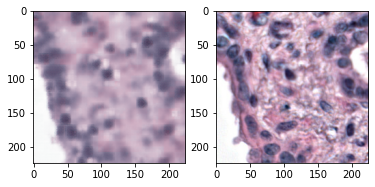

In [24]:
x = vae_image_gen.__getitem__(rints[0]).reshape(224,224,3)
predict(vae, x, inverted=True)

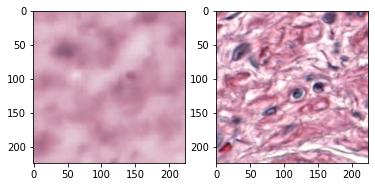

In [25]:
x = vae_image_gen.__getitem__(rints[1]).reshape(224,224,3)
predict(vae, x, inverted=True)

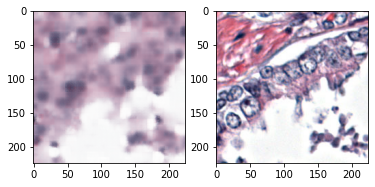

In [26]:
x = vae_image_gen.__getitem__(rints[2]).reshape(224,224,3)
predict(vae, x, inverted=True)

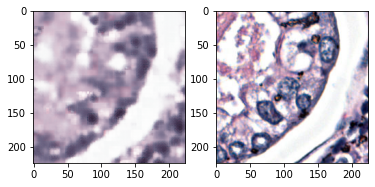

In [27]:
x = vae_image_gen.__getitem__(rints[3]).reshape(224,224,3)
predict(vae, x, inverted=True)

# Training classifier 

In [29]:
def download_adata():
  ''' 
  Downloads:
  1. Human matrisome list 
  2. Three x10 Genomics prostate datasets - Normal, Invasive adenocarcinoma & acinar cellular carcinoma 
  ''' 

  # Matrisome masterlist 
  !wget http://matrisomeproject.mit.edu/static/media/uploads/Files/Human%20in%20silico%20matrisome/matrisome_hs_masterlist.xls

  # Download normal dataset, unzip & place in appropriate folder  
  os.mkdir('Normal')
  !wget https://cf.10xgenomics.com/samples/spatial-exp/1.3.0/Visium_FFPE_Human_Normal_Prostate/Visium_FFPE_Human_Normal_Prostate_filtered_feature_bc_matrix.h5
  !wget  https://cf.10xgenomics.com/samples/spatial-exp/1.3.0/Visium_FFPE_Human_Normal_Prostate/Visium_FFPE_Human_Normal_Prostate_spatial.tar.gz
  !tar -xzvf /content/Visium_FFPE_Human_Normal_Prostate_spatial.tar.gz
  os.replace('spatial', 'Normal/spatial')

  # Download invasive adenocarcinoma dataset 
  os.mkdir('IAC')
  !wget https://cf.10xgenomics.com/samples/spatial-exp/1.3.0/Visium_FFPE_Human_Prostate_Cancer/Visium_FFPE_Human_Prostate_Cancer_filtered_feature_bc_matrix.h5  
  !wget  https://cf.10xgenomics.com/samples/spatial-exp/1.3.0/Visium_FFPE_Human_Prostate_Cancer/Visium_FFPE_Human_Prostate_Cancer_spatial.tar.gz
  !tar -xzvf /content/Visium_FFPE_Human_Prostate_Cancer_spatial.tar.gz
  os.replace('spatial', 'IAC/spatial')
  

  # Download acinar cellular carcinoma dataset 
  os.mkdir('ACC')
  !wget https://cf.10xgenomics.com/samples/spatial-exp/1.3.0/Visium_FFPE_Human_Prostate_Acinar_Cell_Carcinoma/Visium_FFPE_Human_Prostate_Acinar_Cell_Carcinoma_filtered_feature_bc_matrix.h5
  !wget  https://cf.10xgenomics.com/samples/spatial-exp/1.3.0/Visium_FFPE_Human_Prostate_Acinar_Cell_Carcinoma/Visium_FFPE_Human_Prostate_Acinar_Cell_Carcinoma_spatial.tar.gz
  !tar -xzvf /content/Visium_FFPE_Human_Prostate_Acinar_Cell_Carcinoma_spatial.tar.gz
  os.replace('spatial', 'ACC/spatial')

  print('\n - - - - - - - - - - - ')
  print('Downloads complete')
  print(' - - - - - - - - - - - ')
  return 

 # Download adata's  
download_adata()

--2022-11-08 13:40:25--  http://matrisomeproject.mit.edu/static/media/uploads/Files/Human%20in%20silico%20matrisome/matrisome_hs_masterlist.xls
Resolving matrisomeproject.mit.edu (matrisomeproject.mit.edu)... 18.18.159.13
Connecting to matrisomeproject.mit.edu (matrisomeproject.mit.edu)|18.18.159.13|:80... connected.
HTTP request sent, awaiting response... 200 OK
Length: 378880 (370K) [application/vnd.ms-excel]
Saving to: ‘matrisome_hs_masterlist.xls’

matrisome_hs_master 100%[===================>] 370.00K  --.-KB/s    in 0.09s   

2022-11-08 13:40:25 (3.93 MB/s) - ‘matrisome_hs_masterlist.xls’ saved [378880/378880]

--2022-11-08 13:40:26--  https://cf.10xgenomics.com/samples/spatial-exp/1.3.0/Visium_FFPE_Human_Normal_Prostate/Visium_FFPE_Human_Normal_Prostate_filtered_feature_bc_matrix.h5
Resolving cf.10xgenomics.com (cf.10xgenomics.com)... 104.18.1.173, 104.18.0.173, 2606:4700::6812:ad, ...
Connecting to cf.10xgenomics.com (cf.10xgenomics.com)|104.18.1.173|:443... connected.
HTTP req

**NOTE** Directly upload the 'Pathology_unlabeled.csv' from GitHub file into colabs 

In [41]:
# NOTE MANUAL UPLOADING OF 

def load_annotated_data(dataset_name):

    if dataset_name not in ['Normal', 'IAC', 'ACC']:
        print('Select dataset_name from: Normal, IAC, ACC')

    # Load Normal adata and image 
    if dataset_name == 'Normal':
        pf = '/content/Normal'
        cf = '/content/Visium_FFPE_Human_Normal_Prostate_filtered_feature_bc_matrix.h5'
        tissue_positions = pd.read_csv('/content/Normal/spatial/tissue_positions_list.csv')
        full_res_img_path = '/content/Visium_FFPE_Human_Normal_Prostate_image.jpg'

    # Load Stage 3 adata and image 
    if dataset_name == 'IAC':
        pf = '/content/IAC'
        cf = '/content/Visium_FFPE_Human_Prostate_Cancer_filtered_feature_bc_matrix.h5'
        tissue_positions = pd.read_csv('/content/IAC/spatial/tissue_positions_list.csv')
        full_res_img_path = '/content/Visium_FFPE_Human_Prostate_Cancer_image.tif'
        
    if dataset_name == 'ACC':
        pf = '/content/ACC'
        cf = '/content/Visium_FFPE_Human_Prostate_Acinar_Cell_Carcinoma_filtered_feature_bc_matrix.h5'
        tissue_positions = pd.read_csv('/content/ACC/spatial/tissue_positions_list.csv')
        full_res_img_path = '/content/Visium_FFPE_Human_Prostate_Acinar_Cell_Carcinoma_image.tif'

    # Load adata
    print('\n --------------------- ')
    print('Loading adata...')
    adata = sc.read_visium(pf, genome=None, count_file=cf , library_id=None, load_images=True,
                        source_image_path=None)

    # Loads binary version of pathologist notes (only available for IAC)
    if dataset_name == 'IAC':
        print('\n --------------------- ')
        print('Loading histopathologist annotations...')
        path = '/Pathology_unlabeled.csv'
        pathologist_ann = pd.read_csv(path)
        print('\n --------------------- ')
        print('Converting below to non-malignat excluding nan:')
        print(pathologist_ann['Pathology'].unique())
        pathologist_ann['Binary_labels'] = pathologist_ann['Pathology'].replace('Normal gland', 'Non-malignant').replace('Fibro-muscular tissue', 'Non-malignant').replace('Fibrous tissue','Non-malignant').replace('Nerve', 'Non-malignant').replace('Immune Cells', 'Non-malignant').replace('Blood vessel', 'Non-malignant').replace('Invasive carcinoma', 'Malignant')
        adata.obs['truth_label'] = pathologist_ann['Binary_labels'].values

    # Load full resolution TIFF image 
    print('\nLoading full resolution image...')
    full_res_img = Image.open(full_res_img_path)

    # Load and merge tissue positions of spots 
    print('\nLoading tissue positions...')
    adata.obs['Barcode'] = adata.obs.index
    tissue_positions.columns = ['Barcode', 'in_tiss', 'arr_row', 'arr_col', 'pxl_row', 'pxl_col']
    adata.obs = pd.merge(left=adata.obs, right=tissue_positions, left_on='Barcode', right_on='Barcode')
    adata.obs = adata.obs.iloc[:,3:]
    return adata, full_res_img


In [42]:
iac_adata, iac_full_res_img = load_annotated_data(dataset_name='IAC')



 --------------------- 
Loading adata...


/usr/local/lib/python3.7/dist-packages/anndata/_core/anndata.py:1830: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")



 --------------------- 
Loading histopathologist annotations...

 --------------------- 
Converting below to non-malignat excluding nan:
['Normal gland' 'Invasive carcinoma' 'Fibro-muscular tissue' nan
 'Fibrous tissue' 'Nerve' 'Immune Cells' 'Blood vessel']

Loading full resolution image...

Loading tissue positions...


/usr/local/lib/python3.7/dist-packages/anndata/_core/anndata.py:798: UserWarning: 
AnnData expects .obs.index to contain strings, but got values like:
    [0, 1, 2, 3, 4]

    Inferred to be: integer

  value_idx = self._prep_dim_index(value.index, attr)


In [65]:
input_shape = 224

# Generate X - windows around centre spot 
def create_spot_window(centre_x, centre_y, N, im):
  ''' Select NxN window around centre of spot '''
  n = N/2
  left = centre_x - n
  upper = centre_y - n
  right = centre_x + n
  lower = centre_y + n

  im_crop = im.crop((left, upper, right, lower))
  return im_crop
def create_x_y(adata, fullres_image, y_available=True):

  ''' creates windows of 200x200 and class label'''
  if y_available: 
    adata_obs = adata.obs.dropna().reset_index()
    y = adata_obs['truth_label'].values

  adata_obs = adata.obs
  # Take pxl_col, pxl_row - create window
  X = []
  for i in range(len(adata_obs)):
    spot_window = create_spot_window(adata_obs['pxl_col'][i],adata_obs['pxl_row'][i], input_shape, fullres_image)
    X.append(np.array(spot_window))
  if y_available: 
    return X, y
  else:
    return X 
x,y = create_x_y(iac_adata, iac_full_res_img)
np.shape(x), np.shape(y)

((4371, 224, 224, 3), (3760,))

In [46]:
# Invert  and normalize
def invert_image_normalize(image):
    image = np.array(image)
    return (255 - image) / 255 
    
x_inverted = invert_image_normalize(x)

In [45]:
# Encode labels 
le = preprocessing.LabelEncoder()
y = le.fit_transform(y)

In [47]:
# Split train test 
from sklearn.model_selection import train_test_split
x_train, x_test, y_train, y_test = train_test_split(x_inverted, y, test_size=0.2)

In [48]:
def generate_vae_embeddings(vae, x_inverted):
    embeddings = []
    for i in range(len(x_inverted)):
        #print(i)
        _,_, images_embed = vae.encoder(x_inverted[i].reshape(1,224,224,3))
        embeddings.append(images_embed)
    embeddings = np.array(embeddings).reshape(-1,512)
    return embeddings

train_embeddings = generate_vae_embeddings(vae, x_train)

In [49]:
# Train classifier 
callback = tf.keras.callbacks.EarlyStopping(
    monitor='val_loss',
    patience=5
)

act = 'sigmoid'
clsf = tf.keras.Sequential([
    layers.Input(shape=(512)),
    layers.Dense(258, activation=act),
    layers.Dense(64, activation=act),
    layers.Dense(1, activation='sigmoid')
])

clsf.compile(optimizer=tf.keras.optimizers.Adam(learning_rate=0.00001), loss='mse', metrics=['accuracy', 'Recall', 'Precision'])

clsf.fit(x=train_embeddings,epochs=100, y=y_train, validation_split=0.1, callbacks=callback)


Epoch 1/100
85/85 [==============================] - 2s 8ms/step - loss: 0.2487 - accuracy: 0.5124 - recall: 0.0436 - precision: 0.5472 - val_loss: 0.2480 - val_accuracy: 0.4950 - val_recall: 0.0892 - val_precision: 0.6087
Epoch 2/100
85/85 [==============================] - 0s 4ms/step - loss: 0.2404 - accuracy: 0.5955 - recall: 0.2759 - precision: 0.7355 - val_loss: 0.2402 - val_accuracy: 0.6478 - val_recall: 0.4395 - val_precision: 0.7931
Epoch 3/100
85/85 [==============================] - 0s 4ms/step - loss: 0.2335 - accuracy: 0.7015 - recall: 0.5293 - precision: 0.7946 - val_loss: 0.2338 - val_accuracy: 0.7209 - val_recall: 0.5987 - val_precision: 0.8174
Epoch 4/100
85/85 [==============================] - 0s 4ms/step - loss: 0.2270 - accuracy: 0.7614 - recall: 0.6767 - precision: 0.8065 - val_loss: 0.2278 - val_accuracy: 0.7542 - val_recall: 0.6497 - val_precision: 0.8430
Epoch 5/100
85/85 [==============================] - 0s 4ms/step - loss: 0.2207 - accuracy: 0.7898 - recall:

In [52]:
test_embeddings = generate_vae_embeddings(vae, x_test)

# Make prediction using trained classifier 
y_pred = clsf.predict(test_embeddings)
y_pred = np.round(y_pred)

acc = accuracy_score(y_test, y_pred)
results = precision_recall_fscore_support(y_test, y_pred, average='macro')
print('\n------------------------')
print('Performance')
print('Accuracy: ', np.round(acc,4))
print('Macro Precision: ', np.round(float(results[0]), 4))
print('Macro Recall: ', np.round(float(results[1]), 4))
print('Macro F1: ', np.round(float(results[2]), 4))

24/24 [==============================] - 0s 1ms/step

------------------------
Performance
Accuracy:  0.8391
Macro Precision:  0.8368
Macro Recall:  0.8366
Macro F1:  0.8367


# Making predictions using trained VAE/Classifier 

In [57]:
# Reload full adata - above removed spots without histopathologist annt
# for training 

iac_adata, iac_full_res_img = load_annotated_data(dataset_name='IAC')



 --------------------- 
Loading adata...


/usr/local/lib/python3.7/dist-packages/anndata/_core/anndata.py:1830: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")



 --------------------- 
Loading histopathologist annotations...

 --------------------- 
Converting below to non-malignat excluding nan:
['Normal gland' 'Invasive carcinoma' 'Fibro-muscular tissue' nan
 'Fibrous tissue' 'Nerve' 'Immune Cells' 'Blood vessel']

Loading full resolution image...

Loading tissue positions...


/usr/local/lib/python3.7/dist-packages/anndata/_core/anndata.py:798: UserWarning: 
AnnData expects .obs.index to contain strings, but got values like:
    [0, 1, 2, 3, 4]

    Inferred to be: integer

  value_idx = self._prep_dim_index(value.index, attr)


In [58]:
# Set image resolution 
sc.set_figure_params(dpi=300, dpi_save=300, fontsize=10)

## Stage 3 adenocarcinoma 

In [66]:
# Create x around spot centres 
x = create_x_y(iac_adata, iac_full_res_img, y_available=False)

# Invert and normalize 
x_inverted = invert_image_normalize(x)

# Make prediction using trained classifier
iac_embeddings = generate_vae_embeddings(vae, x_inverted)


In [55]:
def classifier_prediction(clsf, adata, embeddings):

    # Make prediction using trained classifier 
    y_pred = clsf.predict(embeddings)
    y_pred = np.round(y_pred)

    # Add predictions to adata
    adata.obs['y_pred'] = y_pred
    adata.obs['y_pred_txt'] = adata.obs['y_pred'].replace(1, 'Non-malignant').replace(0, 'Malignant')
    
    # Plot 
    col_dict = {'Non-malignant': 'g',
        'Malignant': 'r'}
    sc.pl.spatial(adata, color='y_pred_txt', palette=col_dict)
    return 



137/137 [==============================] - 0s 1ms/step


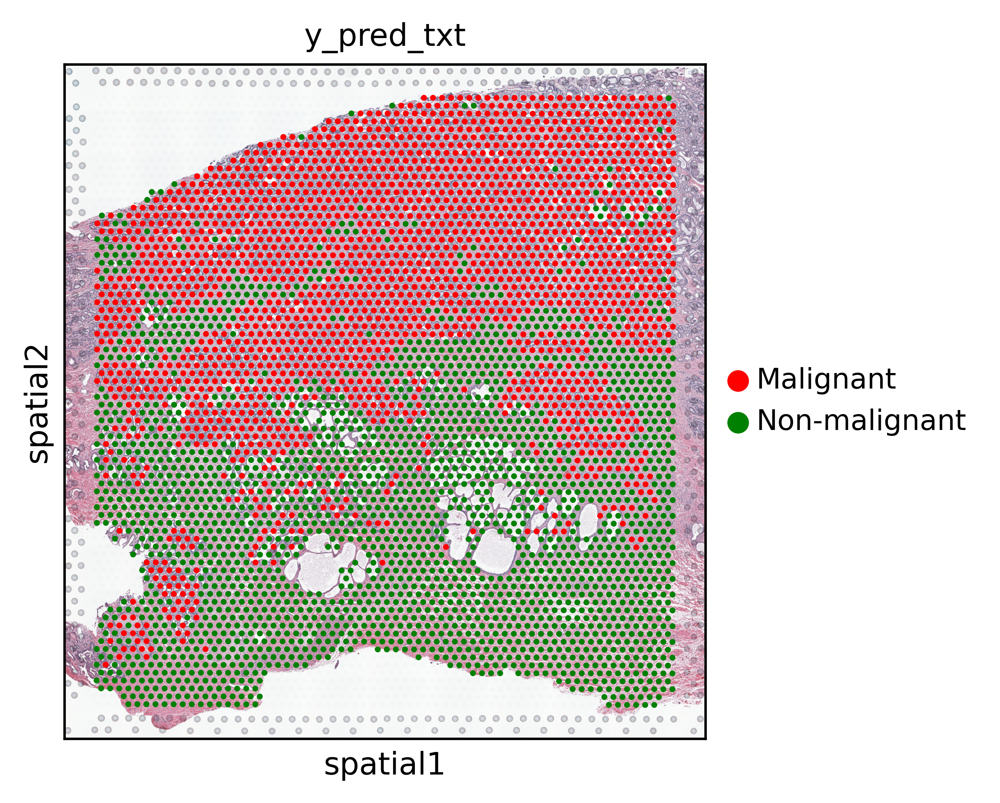

In [68]:
classifier_prediction(clsf, iac_adata, iac_embeddings)

## Normal 


 --------------------- 
Loading adata...


/usr/local/lib/python3.7/dist-packages/anndata/_core/anndata.py:1830: UserWarning: Variable names are not unique. To make them unique, call `.var_names_make_unique`.
  utils.warn_names_duplicates("var")



Loading full resolution image...

Loading tissue positions...


/usr/local/lib/python3.7/dist-packages/anndata/_core/anndata.py:798: UserWarning: 
AnnData expects .obs.index to contain strings, but got values like:
    [0, 1, 2, 3, 4]

    Inferred to be: integer

  value_idx = self._prep_dim_index(value.index, attr)


80/80 [==============================] - 0s 1ms/step


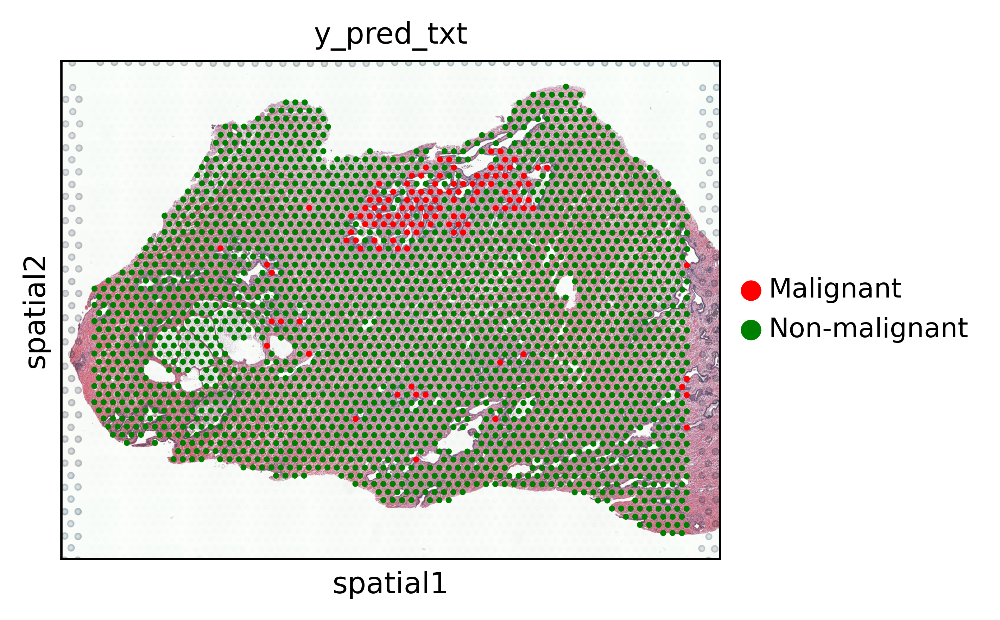

In [70]:
norm_adata, norm_full_res_img = load_annotated_data('Normal')
x = create_x_y(norm_adata, norm_full_res_img, y_available=False)
x_inverted = invert_image_normalize(x)
norm_embeddings = generate_vae_embeddings(vae, x_inverted)
classifier_prediction(clsf, norm_adata, norm_embeddings)

## ACC 


 --------------------- 
Loading adata...

Loading full resolution image...

Loading tissue positions...
96/96 [==============================] - 0s 1ms/step


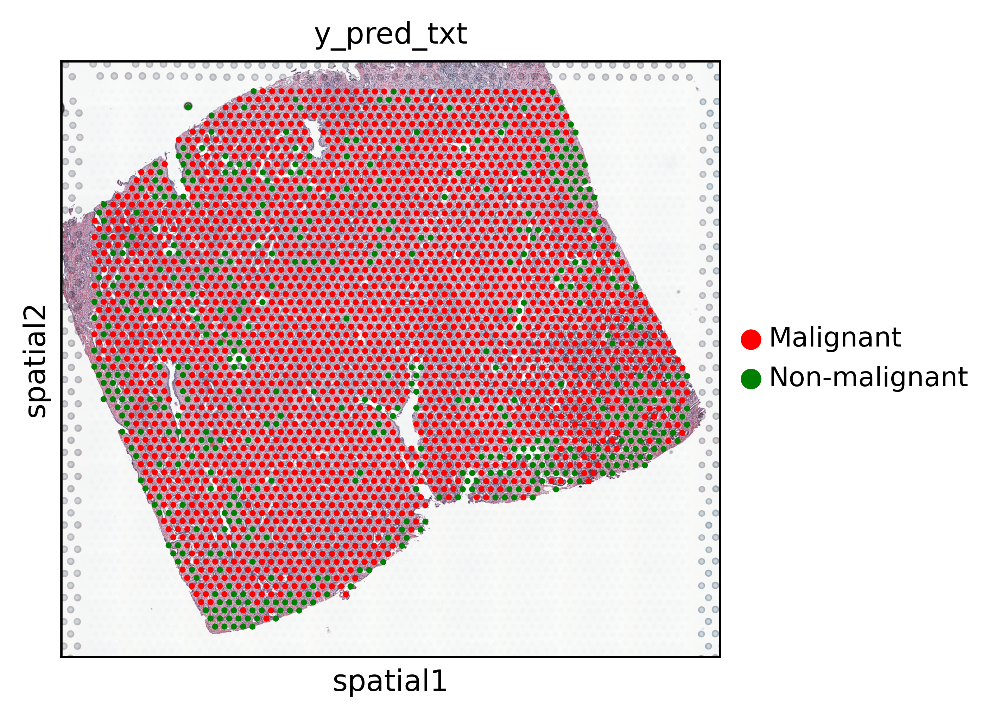

In [71]:
acc_adata, acc_full_res_img = load_annotated_data('ACC')
x = create_x_y(acc_adata, acc_full_res_img, y_available=False)
x_inverted = invert_image_normalize(x)
embeddings = generate_vae_embeddings(vae, x_inverted)
classifier_prediction(clsf, acc_adata, embeddings)